Climate pulse SST and T2M analysis with Matrix Profile (MP) and Interval Matrix Profile (IMP)
==============

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly
import plotly.graph_objects as go
import sys
sys.path.insert(0,'../build/src/')
import libimp

In [2]:
help(libimp)

Help on module libimp:

NAME
    libimp - Pybind11 library for the Interval Matrix Profile (IMP). There is currently only the STOMP implementation for float and double data. It is parallel

FUNCTIONS
    STOMP_double(...) method of builtins.PyCapsule instance
        STOMP_double(time_series: numpy.ndarray[numpy.float64], window_size: int, exclude: int, block_width: int, block_height: int) -> tuple

        Compute the Matrix Profile using the STOMP algorithm. The parameters are as follows:
                time_series: numpy array, the time series data,
                window_size: int, the size of the subsequences,
                exclude: int, the size of the exclusion zone,
                block_width: int, the width of the blocks,
                block_height: int, the height of the blocks.

                Returns a tuple of two numpy arrays: the Matrix Profile and the Matrix Profile Index.

    STOMP_float(...) method of builtins.PyCapsule instance
        STOMP_float(time_series

## Sea Surface Temperature

In [3]:
data_path = "../Data/climate_pulse/SST/"
ts_sst = np.load(data_path+"daily_series.npy").astype(np.float64)
date_sst = np.load(data_path+"daily_series_date.npy")
window_size = 7
interval_length = 61
exclude = 7
start_year = np.datetime64(date_sst[0], 'Y').astype(int) + 1970
end_year = np.datetime64(date_sst[-1], 'Y').astype(int) + 1970
period_starts = []
for year in range(start_year, end_year+1):
    period_starts.append(np.where(date_sst == np.datetime64(str(year) + "-01-01"))[0][0])
block_width = 500
block_height = 500

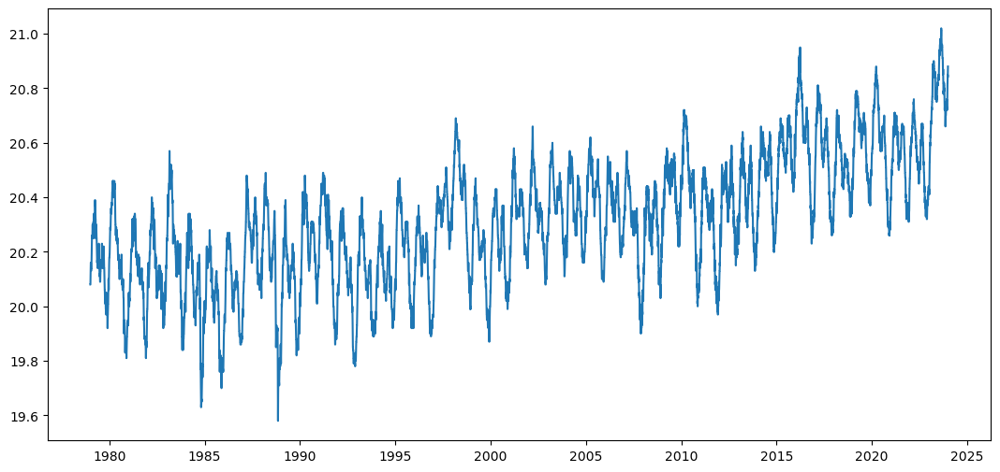

In [4]:
plt.figure(figsize=(13,6))
plt.plot(date_sst, ts_sst)
plt.show()

In [5]:
mp_sst, mp_index_sst = libimp.STOMP_double(ts_sst, window_size, exclude, block_width, block_width)
imp_sst, imp_index_sst = libimp.imp_STOMP_double(ts_sst, window_size, period_starts, interval_length, exclude)

imp_3NN, imp_3NN_index = libimp.imp_STOMP_knn_double(ts_sst, window_size, period_starts, interval_length, exclude, 3)
imp_5NN, imp_5NN_index = libimp.imp_STOMP_knn_double(ts_sst, window_size, period_starts, interval_length, exclude, 5)
imp_10NN, imp_10NN_index = libimp.imp_STOMP_knn_double(ts_sst, window_size, period_starts, interval_length, exclude, 10)


NN_index = np.loadtxt(data_path+"imp_10NN_index.txt").astype(int)

size = len(mp_sst)

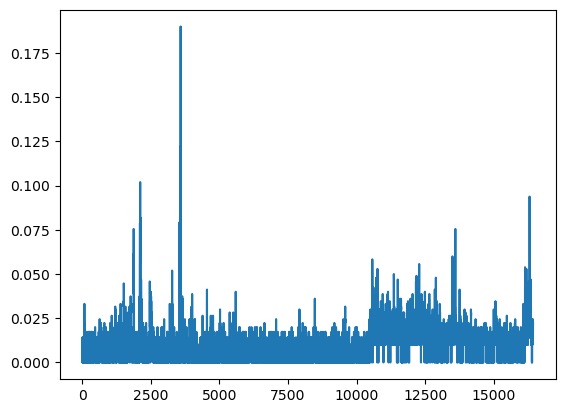

In [6]:
plt.plot(mp_sst)

In [7]:
type(mp_sst), type(mp_index_sst)

(numpy.ndarray, numpy.ndarray)

In [8]:
type(imp_sst), type(imp_index_sst)

(numpy.ndarray, numpy.ndarray)

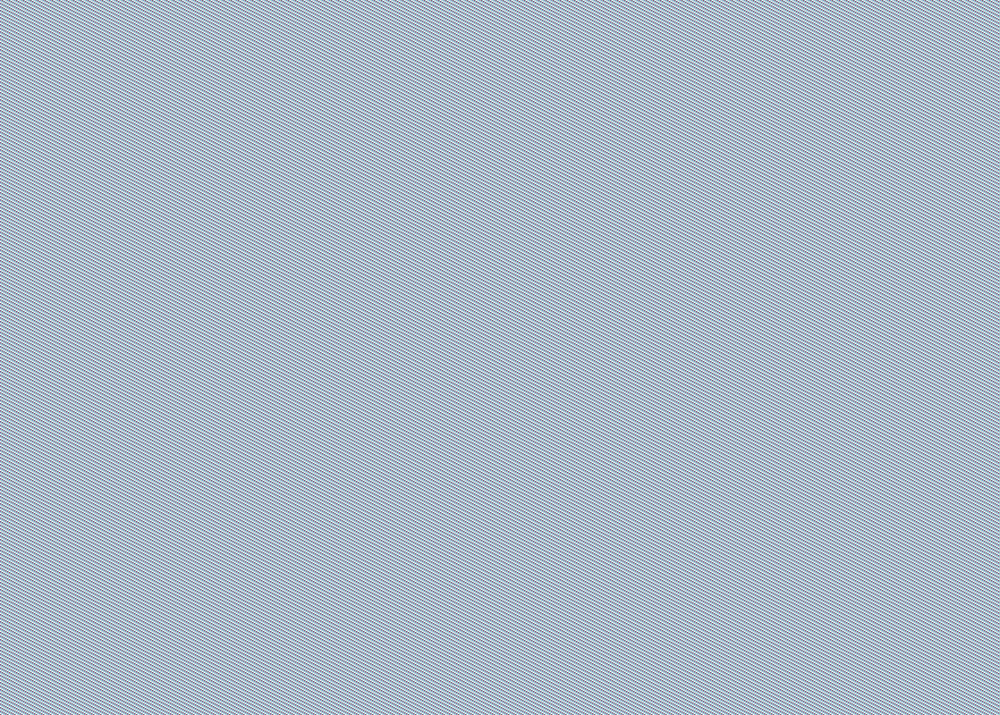

In [9]:
mp_date = date_sst[:size]
ind_discord_mp = np.argpartition(mp_sst, -30)[-30:]
ind_discord_imp = np.argpartition(imp_sst, -30)[-30:]

cut_off_mp = np.min(mp_sst[ind_discord_mp])
cut_off_imp = np.min(imp_sst[ind_discord_imp])

hover_text_mp = [f"NN: {date_sst[ind]}" for ind in mp_index_sst]
hover_text_imp = [f"NN: {date_sst[ind]}" for ind in imp_index_sst]
fig = go.Figure()
# Add traces
fig.add_trace(go.Scatter(x=mp_date, y=imp_sst, mode='lines', name='IMP', text=hover_text_imp))
fig.add_trace(go.Scatter(x=mp_date, y=mp_sst, mode='lines', name='MP', text=hover_text_mp))
fig.add_trace(go.Scatter(x=mp_date, y=np.zeros(mp_date.shape[0]) + cut_off_mp, mode='lines', line=dict(dash='dash',color='red'), name='MP cutoff', hoverinfo='skip'))
fig.add_trace(go.Scatter(x=mp_date, y=np.zeros(mp_date.shape[0]) + cut_off_imp, mode='lines', line=dict(dash='dash',color='blue'), name='IMP cutoff', hoverinfo='skip'))
# Update layout
fig.update_layout(
    title="Sample Plot",
    xaxis_title="Date",
    yaxis_title="Distance",
    legend_title="Method",
    autosize=True,
    #width=1300,
    height=800,
    hovermode='x unified',
)
# Show the figure
fig.show()

In [10]:
fig = go.Figure()
sdate = "2012-08-16"
date = np.where(mp_date==np.datetime64(sdate))[0][0]
y1 = imp_sst[date]
y2 = mp_sst[date]

# Add traces
fig.add_vline(x=sdate, line_width=1, line_dash="dash", line_color="grey")
fig.add_trace(go.Scatter(x=mp_date, y=imp_sst, mode='lines', name='IMP', text=hover_text_imp))
fig.add_trace(go.Scatter(x=mp_date, y=mp_sst, mode='lines', name='MP', text=hover_text_mp))
fig.add_trace(go.Scatter(x=mp_date, y=np.zeros(mp_date.shape[0]) + cut_off_mp, mode='lines', line=dict(dash='dash',color='red'), name='MP cutoff', hoverinfo='skip'))
fig.add_trace(go.Scatter(x=mp_date, y=np.zeros(mp_date.shape[0]) + cut_off_imp, mode='lines', line=dict(dash='dash',color='blue'), name='IMP cutoff', hoverinfo='skip'))

# Update layout
fig.update_layout(
    xaxis_title="Date",
    yaxis_title="Distance",
    autosize=False,
    width=800,
    height=600,
    hovermode='x unified',
    template="plotly_white",
    font_size=20
)
# Add annotation
fig.add_annotation(
    x=sdate,
    y=y1,
    text=f"<b>Distance: {imp_sst[date]:.3f}<br>from {mp_date[imp_index_sst[date]]}</b>",
    showarrow=False,
    yshift=30,font_size=18,bgcolor="white"
)
fig.add_annotation(
    x=sdate,
    y=y2,
    text=f"<b>Distance: {mp_sst[date]:.3f}<br>from {mp_date[mp_index_sst[date]]}</b>",
    showarrow=False,
    yshift=-85,font_size=18,bgcolor="white"
)
fig.update_layout(xaxis_range=['2012-08-07','2012-08-26'], yaxis_range=[0, 0.12])
fig.update_layout(margin=dict(l=20, r=20, t=20, b=20))
fig.update_layout(legend=dict(
    yanchor="middle",
    xanchor="right",
))
# Show the figure
#fig.show()
fig.write_image("mp_vs_imp_sst.pdf", engine="kaleido")

In [11]:
mp_date = date_sst[:size]
ind_discord_3nn = np.argpartition(imp_3NN, -30)[-30:]
ind_discord_5nn = np.argpartition(imp_5NN, -30)[-30:]
ind_discord_10nn = np.argpartition(imp_10NN, -30)[-30:]

cut_off_3 = np.min(imp_3NN[ind_discord_3nn])
cut_off_5 = np.min(imp_5NN[ind_discord_5nn])
cut_off_10 = np.min(imp_10NN[ind_discord_10nn])

hover_text_3 = [f"NN: {mp_date[ind]}" for ind in imp_3NN_index]
hover_text_5 = [f"NN: {mp_date[ind]}" for ind in imp_5NN_index]
hover_text_10 = [f"NN: {mp_date[ind]}" for ind in imp_10NN_index]
fig = go.Figure()
# Add traces
fig.add_trace(go.Scatter(x=mp_date, y=imp_10NN, mode='lines', name='10', text=hover_text_10))
fig.add_trace(go.Scatter(x=mp_date, y=imp_5NN, mode='lines', name='5', text=hover_text_5))
fig.add_trace(go.Scatter(x=mp_date, y=imp_3NN, mode='lines', name='3', text=hover_text_3))
fig.add_trace(go.Scatter(x=mp_date, y=imp_sst, mode='lines',line=dict(color='blue'), name='IMP', text=hover_text_imp))

fig.add_trace(go.Scatter(x=mp_date, y=np.zeros(mp_date.shape[0]) + cut_off_3, mode='lines', line=dict(dash='dash',color='red'), name='3 cutoff', hoverinfo='skip'))
fig.add_trace(go.Scatter(x=mp_date, y=np.zeros(mp_date.shape[0]) + cut_off_5, mode='lines', line=dict(dash='dash',color='blue'), name='5 cutoff', hoverinfo='skip'))
fig.add_trace(go.Scatter(x=mp_date, y=np.zeros(mp_date.shape[0]) + cut_off_10, mode='lines', line=dict(dash='dash',color='blue'), name='10 cutoff', hoverinfo='skip'))
fig.add_trace(go.Scatter(x=mp_date, y=np.zeros(mp_date.shape[0]) + cut_off_imp, mode='lines', line=dict(dash='dash',color='blue'), name='1NN cutoff', hoverinfo='skip'))

# Update layout
fig.update_layout(
    title="Sample Plot",
    xaxis_title="Date",
    yaxis_title="Distance",
    legend_title="Method",
    autosize=True,
    #width=1300,
    height=800,
    hovermode='x unified',
)
# Show the figure
fig.show()

In [12]:
fig = go.Figure()
# Add traces
sdate = "2023-11-08"
date = np.where(mp_date==np.datetime64(sdate))[0][0]
y1 = imp_sst[date]
y2 = imp_3NN[date]

# Add traces
fig.add_vline(x=sdate, line_width=1, line_dash="dash", line_color="grey")
fig.add_trace(go.Scatter(x=mp_date, y=imp_sst, mode='lines', name='1NN', text=hover_text_imp))
fig.add_trace(go.Scatter(x=mp_date, y=imp_3NN, mode='lines', name='3NN', text=hover_text_3))

fig.add_trace(go.Scatter(x=mp_date, y=np.zeros(mp_date.shape[0]) + cut_off_3, mode='lines', line=dict(dash='dash',color='red'), name='3NN cutoff', hoverinfo='skip'))
fig.add_trace(go.Scatter(x=mp_date, y=np.zeros(mp_date.shape[0]) + cut_off_imp, mode='lines', line=dict(dash='dash',color='blue'), name='1NN cutoff', hoverinfo='skip'))
fig.update_layout(xaxis_range=['2023-11-01','2023-11-15'], yaxis_range=[0, 0.123])

# Add annotation
fig.add_annotation(
    x=sdate,
    y=y1,
    text=f"<b>Distance: {imp_sst[date]:.3f}<br>from {mp_date[imp_index_sst[date]]}</b>",
    showarrow=False,
    yshift=-60,font_size=18,bgcolor="white"
)
fig.add_annotation(
    x=sdate,
    y=y2,
    text=f"<b>Distance: {imp_3NN[date]:.3f}<br>from {mp_date[imp_3NN_index[date]]}</b>",
    showarrow=False,
    yshift=40,font_size=18,bgcolor="white"
)

# Update layout
fig.update_layout(
    xaxis_title="Date",
    yaxis_title="Distance",
    autosize=False,
    width=800,
    height=600,
    hovermode='x unified',
    template="plotly_white",
    font_size=20
)
fig.update_layout(legend=dict(
    yanchor="middle",
    xanchor="right",
))
# Show
# Show the figure
fig.write_image("1NN_vs_3NN_sst.pdf", engine="kaleido")

## 2 meter Temperature

In [13]:
data_path_2t = "../Data/climate_pulse/T2M/"
ts_2t = np.load(data_path_2t+"daily_series.npy")
date_2t = np.load(data_path_2t+"daily_series_date.npy")

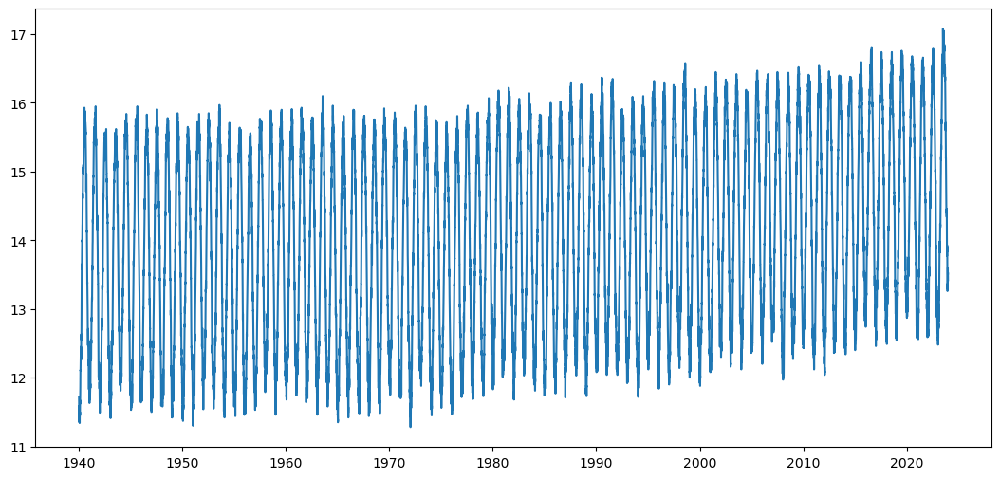

In [14]:
plt.figure(figsize=(13,6))
plt.plot(date_2t, ts_2t)
plt.show()

In [15]:
mp_2t = np.loadtxt(data_path_2t+"mp.txt")
mp_index_2t = np.loadtxt(data_path_2t+"mp_index.txt").astype(int)
imp_2t = np.loadtxt(data_path_2t+"imp.txt")
imp_index_2t = np.loadtxt(data_path_2t+"imp_index.txt").astype(int)
size = mp_2t.shape[0]
mp_date = date_2t[:size]

In [16]:
ind_discord_mp = np.argpartition(mp_2t, -30)[-30:]
ind_discord_imp = np.argpartition(imp_2t, -30)[-30:]

cut_off_mp = np.min(mp_2t[ind_discord_mp])
cut_off_imp = np.min(imp_2t[ind_discord_imp])

hover_text_mp = [f"NN: {date_2t[ind]}" for ind in mp_index_2t]
hover_text_imp = [f"NN: {date_2t[ind]}" for ind in imp_index_2t]
fig = go.Figure()
# Add traces
fig.add_trace(go.Scatter(x=mp_date, y=imp_2t, mode='lines', name='IMP', text=hover_text_imp))
fig.add_trace(go.Scatter(x=mp_date, y=mp_2t, mode='lines', name='MP', text=hover_text_mp))
fig.add_trace(go.Scatter(x=mp_date, y=np.zeros(mp_date.shape[0]) + cut_off_mp, mode='lines', line=dict(dash='dash',color='red'), name='MP cutoff', hoverinfo='skip'))
fig.add_trace(go.Scatter(x=mp_date, y=np.zeros(mp_date.shape[0]) + cut_off_imp, mode='lines', line=dict(dash='dash',color='blue'), name='IMP cutoff', hoverinfo='skip'))
# Update layout
fig.update_layout(
    title="Sample Plot",
    xaxis_title="Date",
    yaxis_title="Distance",
    legend_title="Legend",
    autosize=True,
    #width=1300,
    height=800,
    hovermode='x unified',
    template="plotly_white",
    font_size=16
)
fig.update_layout(
    hoverlabel=dict(
        bgcolor="white",
        font_size=16,
        font_family="Rockwell"
    )
)
# Show the figure
fig.show()
#plotly.offline.plot(fig )


In [17]:
fig = go.Figure()
date = np.where(mp_date==np.datetime64("1952-09-08"))[0][0]
y1 = imp_2t[date]
y2 = mp_2t[date]

# Add traces
fig.add_vline(x='1952-09-08', line_width=1, line_dash="dash", line_color="grey")
fig.add_trace(go.Scatter(x=mp_date, y=imp_2t, mode='lines', name='IMP', text=hover_text_imp))
fig.add_trace(go.Scatter(x=mp_date, y=mp_2t, mode='lines', name='MP', text=hover_text_mp))
fig.add_trace(go.Scatter(x=mp_date, y=np.zeros(mp_date.shape[0]) + cut_off_mp, mode='lines', line=dict(dash='dash',color='red'), name='MP cutoff', hoverinfo='skip'))
fig.add_trace(go.Scatter(x=mp_date, y=np.zeros(mp_date.shape[0]) + cut_off_imp, mode='lines', line=dict(dash='dash',color='blue'), name='IMP cutoff', hoverinfo='skip'))
# Update layout
fig.update_layout(
    xaxis_title="Date",
    yaxis_title="Distance",
    autosize=False,
    width=800,
    height=600,
    hovermode='x unified',
    template="plotly_white",
    font_size=20
)
# Add annotation
fig.add_annotation(
    x='1952-09-08',
    y=y1,
    text=f"<b>Distance: {imp_2t[date]:.3f}<br>from {mp_date[imp_index_2t[date]]}</b>",
    showarrow=False,
    yshift=30,font_size=18,bgcolor="white"
)
fig.add_annotation(
    x='1952-09-08',
    y=y2,
    text=f"<b>Distance: {mp_2t[date]:.3f}<br>from {mp_date[mp_index_2t[date]]}</b>",
    showarrow=False,
    yshift=-30,font_size=18,bgcolor="white"
)
fig.update_layout(xaxis_range=['1952-09-01','1952-09-14'], yaxis_range=[0, 0.22])
fig.update_layout(margin=dict(l=20, r=20, t=20, b=20))
fig.update_layout(legend=dict(
    yanchor="middle",
    xanchor="right",
))
# Show the figure
#fig.show()
#plotly.offline.plot(fig )
fig.write_image("mp_vs_imp_2t.pdf", engine="kaleido")

In [ ]:
imp_3NN = np.loadtxt(data_path_2t+"imp_3NN.txt")
imp_5NN = np.loadtxt(data_path_2t+"imp_5NN.txt")
imp_10NN = np.loadtxt(data_path_2t+"imp_10NN.txt")

imp_3NN_index = np.loadtxt(data_path_2t+"imp_3NN_index.txt").astype(int)
imp_5NN_index = np.loadtxt(data_path_2t+"imp_5NN_index.txt").astype(int)
imp_10NN_index = np.loadtxt(data_path_2t+"imp_10NN_index.txt").astype(int)

mp_date = date_2t[:size]
ind_discord_3nn = np.argpartition(imp_3NN, -30)[-30:]
ind_discord_5nn = np.argpartition(imp_5NN, -30)[-30:]
ind_discord_10nn = np.argpartition(imp_10NN, -30)[-30:]

cut_off_3 = np.min(imp_3NN[ind_discord_3nn])
cut_off_5 = np.min(imp_5NN[ind_discord_5nn])
cut_off_10 = np.min(imp_10NN[ind_discord_10nn])

hover_text_3 = [f"NN: {mp_date[ind]}" for ind in imp_3NN_index]
hover_text_5 = [f"NN: {mp_date[ind]}" for ind in imp_5NN_index]
hover_text_10 = [f"NN: {mp_date[ind]}" for ind in imp_10NN_index]
fig = go.Figure()
# Add traces
fig.add_trace(go.Scatter(x=mp_date, y=imp_10NN, mode='lines', name='10', text=hover_text_10))
fig.add_trace(go.Scatter(x=mp_date, y=imp_5NN, mode='lines', name='5', text=hover_text_5))
fig.add_trace(go.Scatter(x=mp_date, y=imp_3NN, mode='lines', name='3', text=hover_text_3))
fig.add_trace(go.Scatter(x=mp_date, y=imp_2t, mode='lines', name='IMP', text=hover_text_imp))

fig.add_trace(go.Scatter(x=mp_date, y=np.zeros(mp_date.shape[0]) + cut_off_3, mode='lines', line=dict(dash='dash'), name='3 cutoff', hoverinfo='skip'))
fig.add_trace(go.Scatter(x=mp_date, y=np.zeros(mp_date.shape[0]) + cut_off_5, mode='lines', line=dict(dash='dash'), name='5 cutoff', hoverinfo='skip'))
fig.add_trace(go.Scatter(x=mp_date, y=np.zeros(mp_date.shape[0]) + cut_off_10, mode='lines', line=dict(dash='dash'), name='10 cutoff', hoverinfo='skip'))
fig.add_trace(go.Scatter(x=mp_date, y=np.zeros(mp_date.shape[0]) + cut_off_imp, mode='lines', line=dict(dash='dash'), name='1NN cutoff', hoverinfo='skip'))

# Update layout
fig.update_layout(
    title="Sample Plot",
    xaxis_title="Date",
    yaxis_title="Distance",
    legend_title="Method",
    autosize=True,
    #width=1300,
    height=800,
    hovermode='x unified',
)
# Show the figure
fig.show()

In [ ]:
fig = go.Figure()
# Add traces
sdate = "2018-04-14"
date = np.where(mp_date==np.datetime64(sdate))[0][0]
y1 = imp_2t[date]
y2 = imp_3NN[date]

# Add traces
fig.add_vline(x=sdate, line_width=1, line_dash="dash", line_color="grey")
fig.add_trace(go.Scatter(x=mp_date, y=imp_2t, mode='lines', name='1NN', text=hover_text_imp))
fig.add_trace(go.Scatter(x=mp_date, y=imp_3NN, mode='lines', name='3NN', text=hover_text_3))

fig.add_trace(go.Scatter(x=mp_date, y=np.zeros(mp_date.shape[0]) + cut_off_3, mode='lines', line=dict(dash='dash',color='red'), name='3NN cutoff', hoverinfo='skip'))
fig.add_trace(go.Scatter(x=mp_date, y=np.zeros(mp_date.shape[0]) + cut_off_imp, mode='lines', line=dict(dash='dash',color='blue'), name='1NN cutoff', hoverinfo='skip'))
fig.update_layout(xaxis_range=['2018-04-05','2018-04-24'], yaxis_range=[0, 0.25])

# Add annotation
fig.add_annotation(
    x=sdate,
    y=y1,
    text=f"<b>Distance: {imp_2t[date]:.3f}<br>from {mp_date[imp_index_2t[date]]}</b>",
    showarrow=False,
    yshift=-60,font_size=18,bgcolor="white"
)
fig.add_annotation(
    x=sdate,
    y=y2,
    text=f"<b>Distance: {imp_3NN[date]:.3f}<br>from {mp_date[imp_3NN_index[date]]}</b>",
    showarrow=False,
    yshift=40,font_size=18,bgcolor="white"
)

# Update layout
fig.update_layout(
    xaxis_title="Date",
    yaxis_title="Distance",
    autosize=False,
    width=800,
    height=600,
    hovermode='x unified',
    template="plotly_white",
    font_size=20
)
fig.update_layout(legend=dict(
    yanchor="middle",
    xanchor="right",
))
# Show
# Show the figure
fig.write_image("1NN_vs_3NN_2t.pdf", engine="kaleido")